<a href="https://colab.research.google.com/github/kungfumas/aplikasi-deep-learning/blob/master/multipersonmediapipe2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install -qr https://raw.githubusercontent.com/ultralytics/yolov5/master/requirements.txt

     |████████████████████████████████| 596 kB 9.3 MB/s 


https://shawntng.medium.com/multi-person-pose-estimation-with-mediapipe-52e6a60839dd

In [ ]:
!pip install pytube

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 56 kB 3.6 MB/s 


In [ ]:
from pytube import YouTube
yt = YouTube("https://www.youtube.com/watch?v=at9S3435GYo")
stream = yt.streams.get_highest_resolution()
stream.download()

'/content/FINAL TUNGGAL ANAK PUTRA BPR BESTARI CUP 2020 (DUTA VS DARRICH).mp4'

In [ ]:
import torch
torch.cuda.is_available()

True

In [ ]:
! nvidia-smi

Sun Jul  3 11:51:34 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   42C    P8    10W /  70W |      3MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
!pip install -qr https://raw.githubusercontent.com/ultralytics/yolov5/master/requirements.txt
!pip install opencv-python mediapipe torch

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 32.9 MB 1.2 MB/s 


In [ ]:
# Import everything needed to edit video clips 
from moviepy.editor import *
     
# loading video dsa gfg intro video 
clip = VideoFileClip("/content/FINAL TUNGGAL ANAK PUTRA BPR BESTARI CUP 2020 (DUTA VS DARRICH).mp4") 
      
 
   
# cutting out some part from the clip
clip = clip.subclip(180, 600)
clip.write_videofile("data.mp4", codec="mpeg4")


Imageio: 'ffmpeg-linux64-v3.3.1' was not found on your computer; downloading it now.
Try 1. Download from https://github.com/imageio/imageio-binaries/raw/master/ffmpeg/ffmpeg-linux64-v3.3.1 (43.8 MB)
Downloading: 8192/45929032 bytes (0.0%)3284992/45929032 bytes (7.2%)7446528/45929032 bytes (16.2%)11599872/45929032 bytes (25.3%)15597568/45929032 bytes (34.0%)18407424/45929032 bytes (40.1%)21250048/45929032 bytes (46.3%)24838144/45929032 bytes (54.1%)28835840/45929032 bytes (62.8%)32579584/45929032 bytes (70.9%)36741120/45929032 bytes (80.0%)39927808/45929032 bytes (86.9%)42754048/45929032 bytes (93.1%)

100%|██████████| 9262/9262 [00:16<00:00, 578.75it/s]

[MoviePy] Done.
[MoviePy] Writing video data.mp4



100%|██████████| 12588/12588 [02:34<00:00, 81.64it/s]

[MoviePy] Done.
[MoviePy] >>>> Video ready: data.mp4 



In [ ]:
import os
import matplotlib.pyplot as plt

from PIL import Image
import cv2

import mediapipe as mp
from mediapipe.python.solutions import pose as mp_pose

#if you are using colab
from google.colab.patches import cv2_imshow

# PyTorch Hub
import torch

# Model
yolo_model = torch.hub.load('ultralytics/yolov5', 'yolov5s')

#since we are only intrested in detecting person
yolo_model.classes=[0]

mp_drawing = mp.solutions.drawing_utils
mp_pose =mp.solutions.pose

video_path ="/content/data.mp4"

#get the dimension of the video
cap = cv2.VideoCapture(video_path)
while cap.isOpened():
    ret, frame = cap.read()
    h, w, _ = frame.shape
    size = (w, h)
    print(size)
    break

cap = cv2.VideoCapture(video_path)

#for webacam cv2.VideoCapture(NUM) NUM -> 0,1,2 for primary and secondary webcams..

#For saving the video file as output.avi
out = cv2.VideoWriter("output5.avi", cv2.VideoWriter_fourcc(*"MJPG"), 20, size)
while cap.isOpened():    
    ret, frame = cap.read()
    if not ret:
      break
    # Recolor Feed from RGB to BGR
    image = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    #making image writeable to false improves prediction
    image.flags.writeable = False    

    result = yolo_model(image)    
    
    # Recolor image back to BGR for rendering
    image.flags.writeable = True   
    image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
    # print(result.xyxy)  # img1 predictions (tensor)

    #This array will contain crops of images incase we need it 
    img_list =[]
    
    #we need some extra margin bounding box for human crops to be properly detected
    MARGIN=10

    for (xmin, ymin, xmax,   ymax,  confidence,  clas) in result.xyxy[0].tolist():
      with mp_pose.Pose(min_detection_confidence=0.3, min_tracking_confidence=0.3) as pose:
        #Media pose prediction ,we are 
        results = pose.process(image[int(ymin)+MARGIN:int(ymax)+MARGIN,int(xmin)+MARGIN:int(xmax)+MARGIN:])

        #Draw landmarks on image, if this thing is confusing please consider going through numpy array slicing 
        mp_drawing.draw_landmarks(image[int(ymin)+MARGIN:int(ymax)+MARGIN,int(xmin)+MARGIN:int(xmax)+MARGIN:], results.pose_landmarks, mp_pose.POSE_CONNECTIONS,
                            mp_drawing.DrawingSpec(color=(245,117,66), thickness=2, circle_radius=2), 
                            mp_drawing.DrawingSpec(color=(245,66,230), thickness=2, circle_radius=2) 
                              ) 
        img_list.append(image[int(ymin):int(ymax),int(xmin):int(xmax):])
    # cv2_imshow(image)

    # writing in the video file 
    out.write(image)

    ## Code to quit the video incase you are using the webcam             
    # cv2.imshow('Activity recognition', image)
    # if cv2.waitKey(10) & 0xFF == ord('q'):
    #     break

cap.release()
out.release()
cv2.destroyAllWindows()

Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
requirements: PyYAML>=5.3.1 not found and is required by YOLOv5, attempting auto-update...
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/

requirements: 1 package updated per /root/.cache/torch/hub/ultralytics_yolov5_master/requirements.txt
requirements: ⚠️ Restart runtime or rerun command for updates to take effect

YOLOv5 🚀 2022-7-3 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients
Adding AutoShape... 


(1280, 720)


In [ ]:
!pip install tensorflow==2.4.1 tensorflow-gpu==2.4.1 tensorflow-hub opencv-python matplotlib

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 394.3 MB 9.2 kB/s 
     |████████████████████████████████| 394.3 MB 16 kB/s 
     |████████████████████████████████| 132 kB 72.7 MB/s 
     |████████████████████████████████| 3.8 MB 56.4 MB/s 
     |████████████████████████████████| 462 kB 68.5 MB/s 
     |████████████████████████████████| 14.8 MB 40.8 MB/s 
     |████████████████████████████████| 2.9 MB 46.0 MB/s 
  Created wheel for wrapt: filename=wrapt-1.12.1-cp37-cp37m-linux_x86_64.whl size=68722 sha256=32c902ff82595b9a1301907bb7dfa618fd90272fdc8d7812f029888581700da7
  Stored in directory: /root/.cache/pip/wheels/62/76/4c/aa25851149f3f6d9785f6c869387ad82b3fd37582fa8147ac6
Successfully built wrapt
  Attempting uninstall: typing-extensions
    Found existing installation: typing-extensions 4.1.1
    Uninstalling typing-extensions-4.1.1:
      Successfully uninstalled typing-extensions-4.1.1
  Att

In [ ]:
import tensorflow as tf
import tensorflow_hub as hub
import cv2
from matplotlib import pyplot as plt
import numpy as np

In [ ]:
# Optional if you are using a GPU
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)

In [ ]:
model = hub.load('https://tfhub.dev/google/movenet/multipose/lightning/1')
movenet = model.signatures['serving_default']

In [ ]:
# Function to loop through each person detected and render
def loop_through_people(frame, keypoints_with_scores, edges, confidence_threshold):
    for person in keypoints_with_scores:
        draw_connections(frame, person, edges, confidence_threshold)
        draw_keypoints(frame, person, confidence_threshold)

In [ ]:
def draw_keypoints(frame, keypoints, confidence_threshold):
    y, x, c = frame.shape
    shaped = np.squeeze(np.multiply(keypoints, [y,x,1]))
    
    for kp in shaped:
        ky, kx, kp_conf = kp
        if kp_conf > confidence_threshold:
            cv2.circle(frame, (int(kx), int(ky)), 6, (0,255,0), -1)

In [ ]:
EDGES = {
    (0, 1): 'm',
    (0, 2): 'c',
    (1, 3): 'm',
    (2, 4): 'c',
    (0, 5): 'm',
    (0, 6): 'c',
    (5, 7): 'm',
    (7, 9): 'm',
    (6, 8): 'c',
    (8, 10): 'c',
    (5, 6): 'y',
    (5, 11): 'm',
    (6, 12): 'c',
    (11, 12): 'y',
    (11, 13): 'm',
    (13, 15): 'm',
    (12, 14): 'c',
    (14, 16): 'c'
}

In [ ]:
def draw_connections(frame, keypoints, edges, confidence_threshold):
    y, x, c = frame.shape
    shaped = np.squeeze(np.multiply(keypoints, [y,x,1]))
    
    for edge, color in edges.items():
        p1, p2 = edge
        y1, x1, c1 = shaped[p1]
        y2, x2, c2 = shaped[p2]
        
        if (c1 > confidence_threshold) & (c2 > confidence_threshold):      
            cv2.line(frame, (int(x1), int(y1)), (int(x2), int(y2)), (0,0,255), 4)

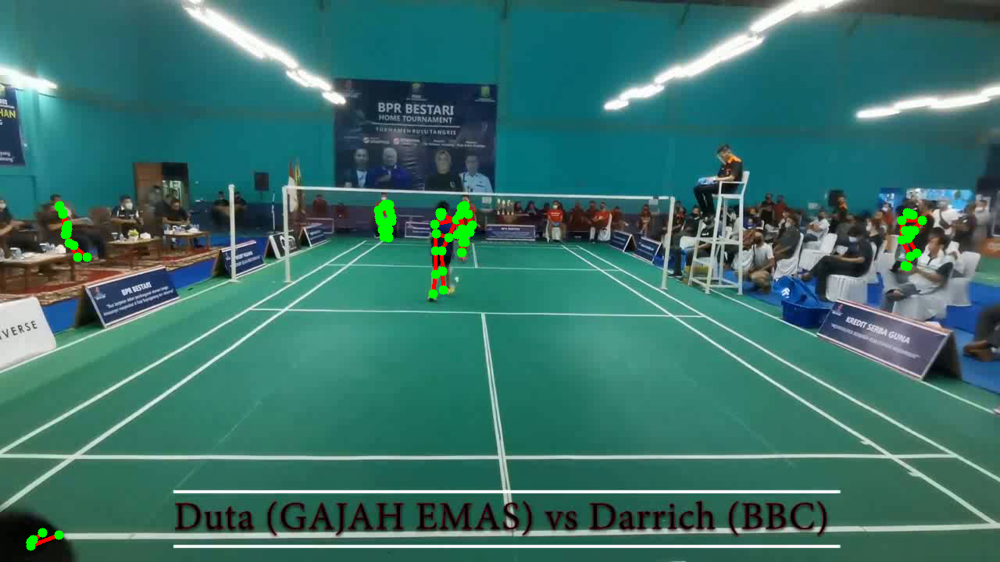

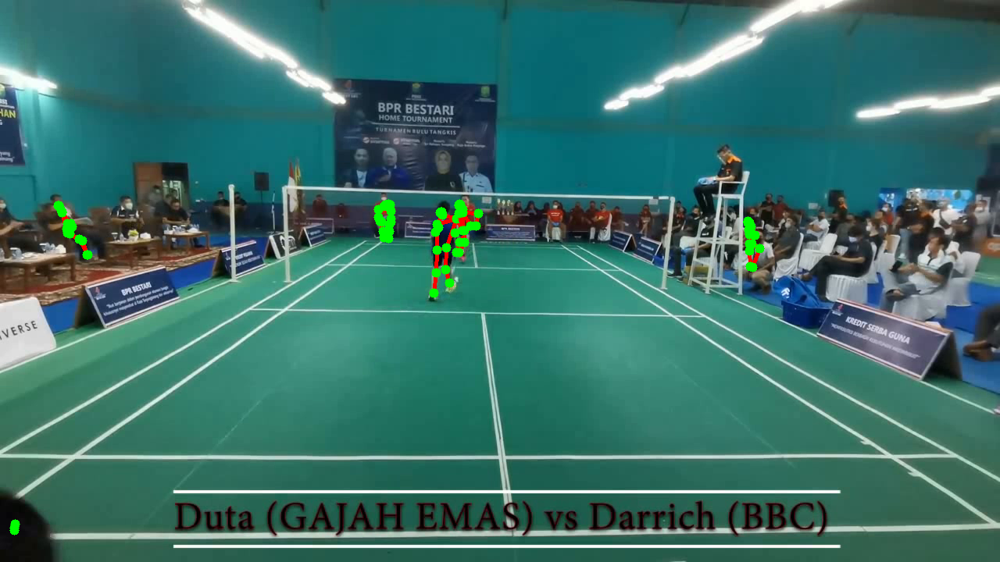

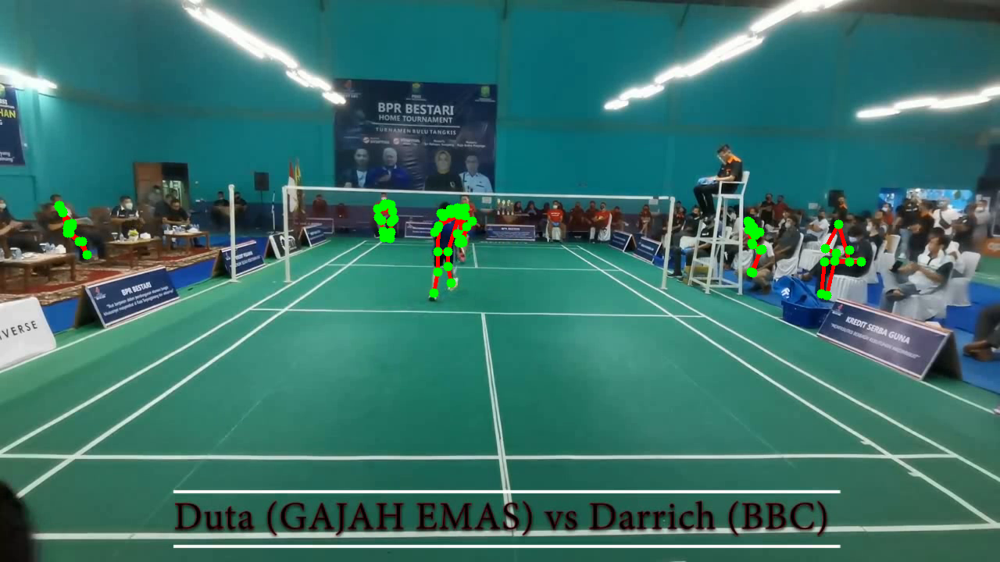

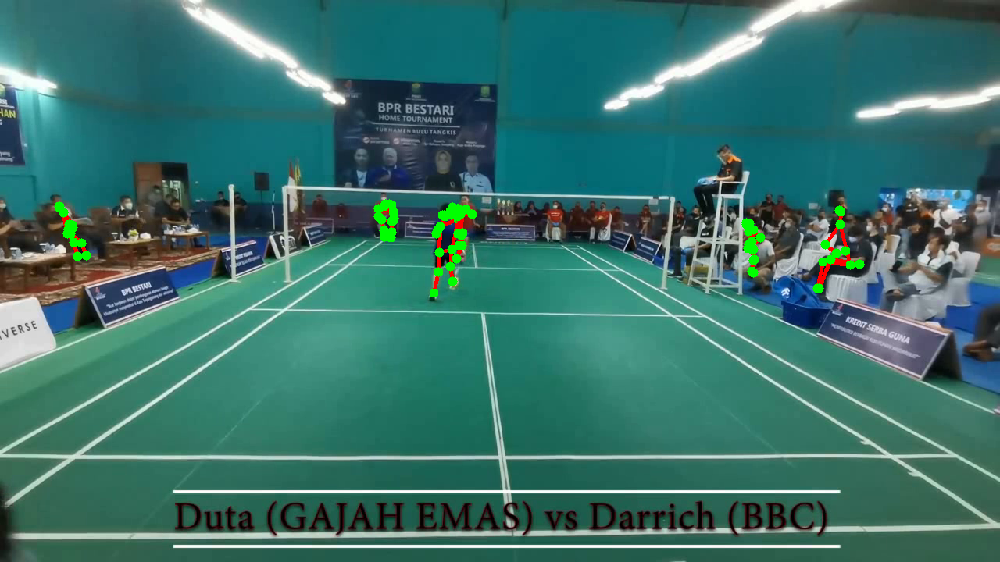

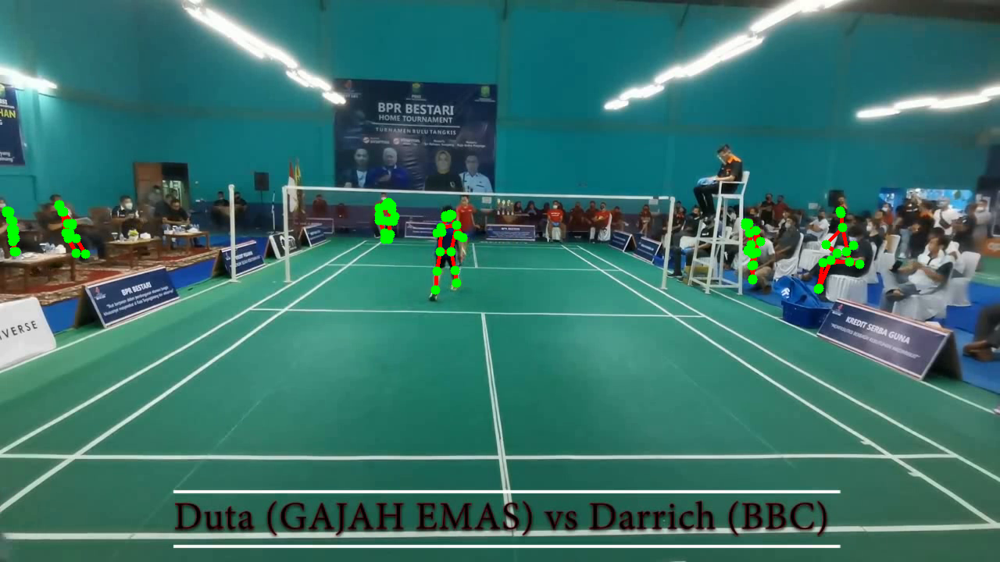

...

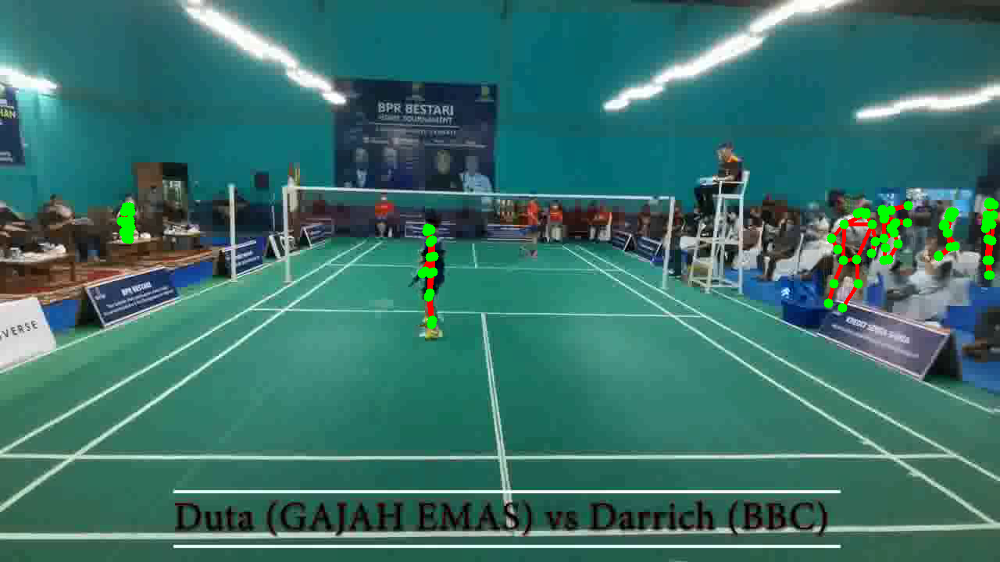

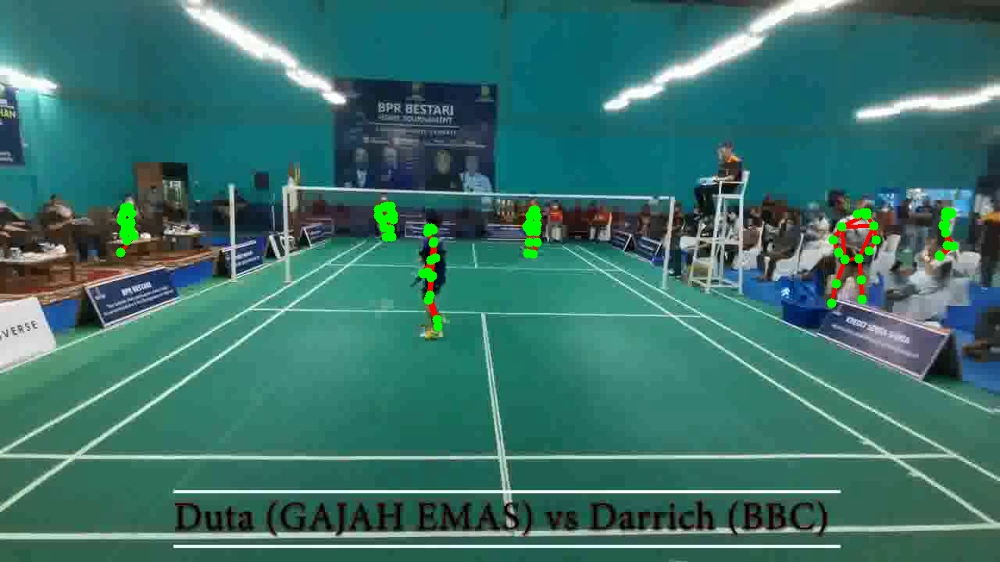

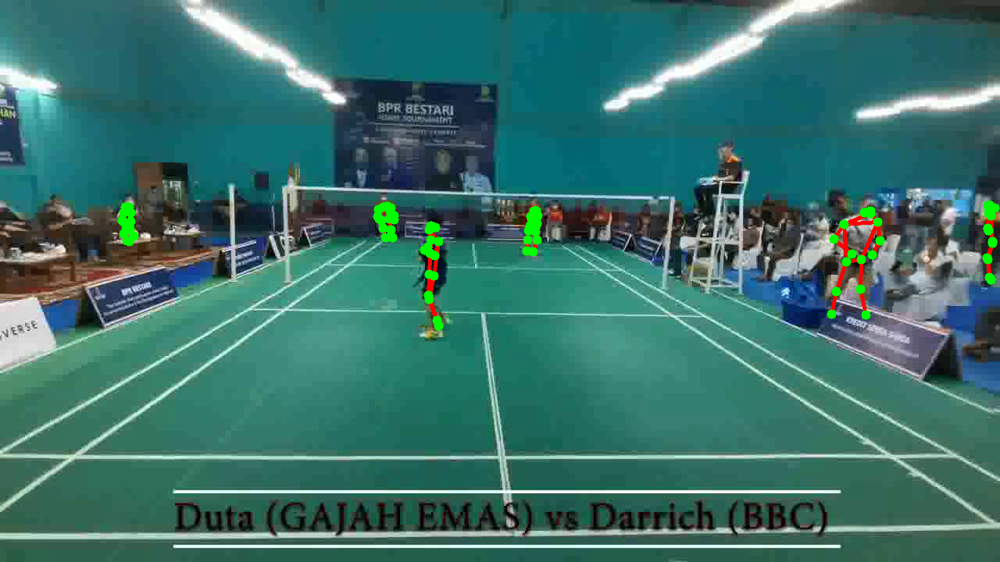

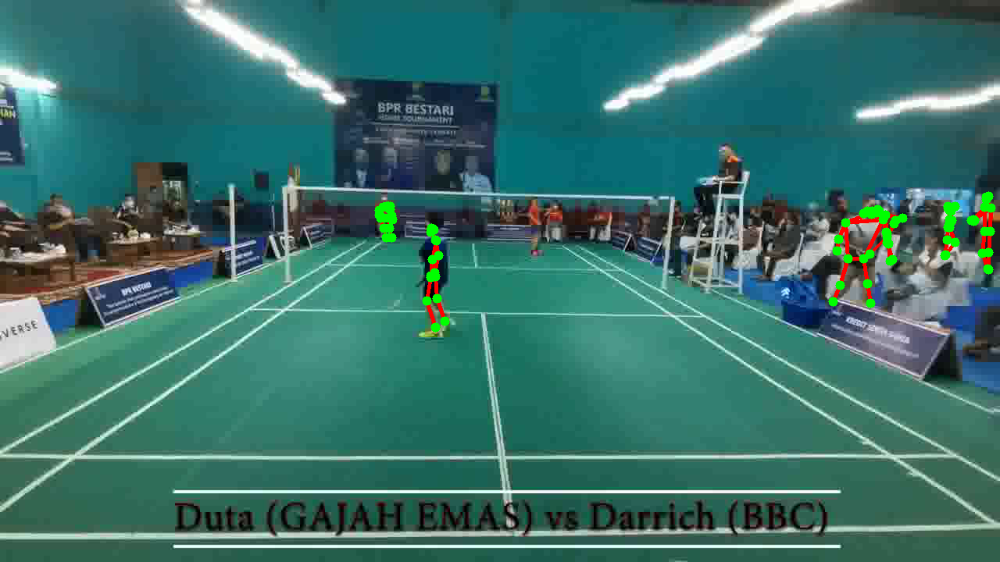

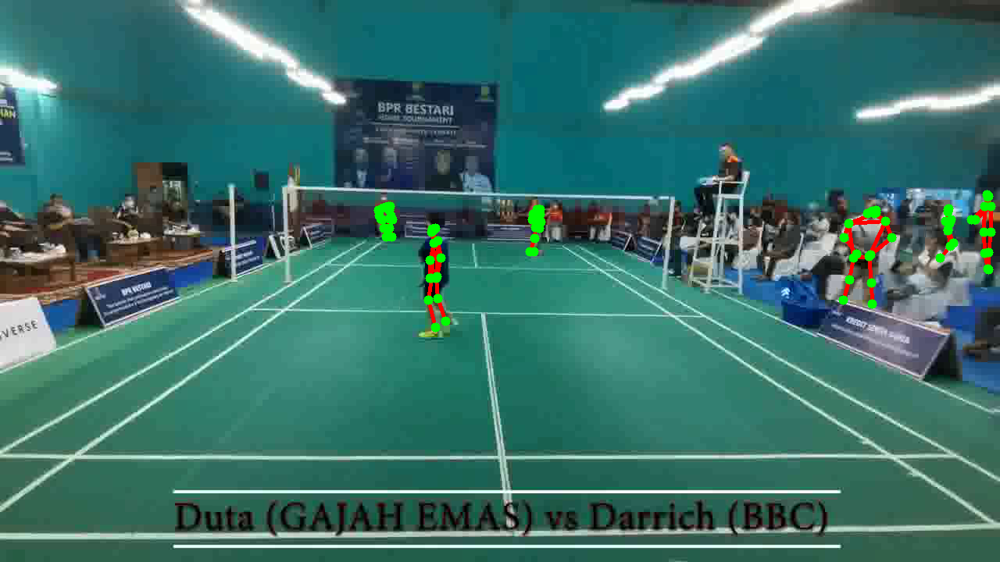

Buffered data was truncated after reaching the output size limit.

In [ ]:
from google.colab.patches import cv2_imshow
cap = cv2.VideoCapture('/content/data.mp4')
while cap.isOpened():
    ret, frame = cap.read()
    
    # Resize image
    img = frame.copy()
    img = tf.image.resize_with_pad(tf.expand_dims(img, axis=0), 384,640)
    input_img = tf.cast(img, dtype=tf.int32)
    
    # Detection section
    results = movenet(input_img)
    keypoints_with_scores = results['output_0'].numpy()[:,:,:51].reshape((6,17,3))
    
    # Render keypoints 
    loop_through_people(frame, keypoints_with_scores, EDGES, 0.1)
    
    cv2_imshow(frame)
    
    if cv2.waitKey(10) & 0xFF==ord('q'):
        break
cap.release()
cv2.destroyAllWindows()

In [ ]:
keypoints_with_scores

array([[[0.48139572, 0.42485377, 0.4361152 ],
        [0.476928  , 0.42317674, 0.38785195],
        [0.47771245, 0.42338094, 0.40224835],
        [0.48053473, 0.4177076 , 0.4717005 ],
        [0.48154807, 0.4174111 , 0.416813  ],
        [0.5005616 , 0.4159864 , 0.5262357 ],
        [0.50665987, 0.41561562, 0.7556845 ],
        [0.52867126, 0.42675787, 0.49768028],
        [0.53967506, 0.42894918, 0.38391793],
        [0.5424613 , 0.4403382 , 0.31886315],
        [0.5473245 , 0.44488642, 0.37080353],
        [0.5650424 , 0.40940738, 0.75713855],
        [0.5665903 , 0.4091951 , 0.75642294],
        [0.57119006, 0.43807077, 0.3437464 ],
        [0.5716729 , 0.44374496, 0.6589736 ],
        [0.61046785, 0.39855012, 0.57024324],
        [0.6346592 , 0.4478209 , 0.7350773 ]],

       [[0.3771808 , 0.93729717, 0.25783575],
        [0.37608165, 0.93820506, 0.25585148],
        [0.37631962, 0.9378891 , 0.2752188 ],
        [0.37660676, 0.93914634, 0.27258512],
        [0.37699163, 0.93829215,

https://chowdera.com/2022/131/202205112056061332.html